In [1]:
import pandas as pd
import numpy as np
import torch
import torch.nn as nn
import seaborn as sn
import matplotlib.pyplot as plt


from itables import init_notebook_mode

init_notebook_mode(all_interactive=True)

<IPython.core.display.Javascript object>

### Load the dataset

In [2]:
kwf2_paths = [
    "./UK/Kelmarsh_SCADA_2016_3082/Turbine_Data_Kelmarsh_2_2016-01-03_-_2017-01-01_229.csv",
    "./UK/Kelmarsh_SCADA_2017_3083/Turbine_Data_Kelmarsh_2_2017-01-01_-_2018-01-01_229.csv",
    "./UK/Kelmarsh_SCADA_2018_3084/Turbine_Data_Kelmarsh_2_2018-01-01_-_2019-01-01_229.csv",
    "./UK/Kelmarsh_SCADA_2019_3085/Turbine_Data_Kelmarsh_2_2019-01-01_-_2020-01-01_229.csv",
    "./UK/Kelmarsh_SCADA_2020_3086/Turbine_Data_Kelmarsh_2_2020-01-01_-_2021-01-01_229.csv",
    "./UK/Kelmarsh_SCADA_2021_3087/Turbine_Data_Kelmarsh_2_2021-01-01_-_2021-07-01_229.csv"
]

kwf2 = pd.DataFrame()

for path in kwf2_paths:

    df = pd.read_csv(
        path,
        skiprows =9
        )
    kwf2 = pd.concat([kwf2, df])

kwf2 = kwf2.rename(columns = {'# Date and time':'time'})
    

### Inspect the data

In [3]:
print(kwf2)

                      time  Wind speed (m/s)  \
0      2016-01-03 00:00:00               NaN   
1      2016-01-03 00:10:00               NaN   
2      2016-01-03 00:20:00               NaN   
3      2016-01-03 00:30:00               NaN   
4      2016-01-03 00:40:00               NaN   
...                    ...               ...   
26059  2021-06-30 23:10:00              3.85   
26060  2021-06-30 23:20:00              4.06   
26061  2021-06-30 23:30:00              4.00   
26062  2021-06-30 23:40:00              3.59   
26063  2021-06-30 23:50:00              3.42   

       Wind speed, Standard deviation (m/s)  Wind speed, Minimum (m/s)  \
0                                       NaN                        NaN   
1                                       NaN                        NaN   
2                                       NaN                        NaN   
3                                       NaN                        NaN   
4                                       NaN          

In [4]:
kwf2.describe()

Wind speed (m/s)  Wind speed, Standard deviation (m/s)  \
count     282021.000000                         195344.000000   
mean           6.457120                              0.889793   
std            2.819366                              0.460713   
min            0.000000                              0.000000   
25%            4.469000                              0.556589   
50%            6.229415                              0.803866   
75%            8.162886                              1.127582   
max           26.389881                              5.740880   

       Wind speed, Minimum (m/s)  Wind speed, Maximum (m/s)  \
count              195344.000000              195344.000000   
mean                    4.768730                   8.195637   
std                     2.324638                   3.583963   
min                     0.000000                   0.098438   
25%                     3.098515                   5.686128   
50%                     4.680782                   7.742758   
75%                     6.248571                  10.284431   
max                    21.167084                  32.346001   

       Long Term Wind (m/s)  Wind speed Sensor 1 (m/s)  \
count         288864.000000              209930.000000   
mean               6.134347                   6.638716   
std                0.673818                   2.875127   
min                5.200000                   0.000000   
25%                5.700000                   4.652990   
50%                5.700000                   6.405562   
75%                6.900000                   8.397436   
max                7.100000                  26.557840   

       Wind speed Sensor 1, Standard deviation (m/s)  \
count                                  194682.000000   
mean                                        0.809916   
std                                         0.418033   
min                                         0.000000   
25%                                         0.502698   
50%                                         0.742592   
75%                                         1.036836   
max                                         4.986292   

       Wind speed Sensor 1, Minimum (m/s)  Wind speed Sensor 1, Maximum (m/s)  \
count                       192779.000000                       194682.000000   
mean                             5.185919                            8.233034   
std                              2.372978                            3.517372   
min                              0.000000                            0.000000   
25%                              3.538838                            5.785436   
50%                              5.091677                            7.816731   
75%                              6.653441                           10.354494   
max                             20.509050                           34.319450   

       Wind speed Sensor 2 (m/s)  ...  Tower Acceleration y (mm/ss)  \
count              210654.000000  ...                 208211.000000   
mean                    6.447384  ...                     28.450763   
std                     2.854786  ...                     18.324022   
min                     0.121257  ...                      2.515251   
25%                     4.416175  ...                     16.127810   
50%                     6.193682  ...                     24.996609   
75%                     8.174820  ...                     36.721218   
max                    25.876762  ...                    283.514594   

       Tower Acceleration X, Min (mm/ss)  Tower Acceleration X, Max (mm/ss)  \
count                       72155.000000                       72155.000000   
mean                           13.098174                         112.810878   
std                             9.731656                          69.437974   
min                             1.058571                           3.317408   
25%                             6.312737                    

In [5]:
kwf2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 288864 entries, 0 to 26063
Columns: 299 entries, time to Tower Acceleration Y, StdDev (mm/ss)
dtypes: float64(295), int64(3), object(1)
memory usage: 661.2+ MB


In [6]:
kwf2.columns.values

array(['time', 'Wind speed (m/s)', 'Wind speed, Standard deviation (m/s)',
       'Wind speed, Minimum (m/s)', 'Wind speed, Maximum (m/s)',
       'Long Term Wind (m/s)', 'Wind speed Sensor 1 (m/s)',
       'Wind speed Sensor 1, Standard deviation (m/s)',
       'Wind speed Sensor 1, Minimum (m/s)',
       'Wind speed Sensor 1, Maximum (m/s)', 'Wind speed Sensor 2 (m/s)',
       'Wind speed Sensor 2, Standard deviation (m/s)',
       'Wind speed Sensor 2, Minimum (m/s)',
       'Wind speed Sensor 2, Maximum (m/s)',
       'Density adjusted wind speed (m/s)', 'Wind direction (°)',
       'Nacelle position (°)', 'Wind direction, Standard deviation (°)',
       'Wind direction, Minimum (°)', 'Wind direction, Maximum (°)',
       'Nacelle position, Standard deviation (°)',
       'Nacelle position, Minimum (°)', 'Nacelle position, Maximum (°)',
       'Vane position 1+2 (°)', 'Vane position 1+2, Max (°)',
       'Vane position 1+2, Min (°)', 'Vane position 1+2, StdDev (°)',
       'Energy 

## Select features for prediction

In [7]:
print(pd.concat([kwf2["Power (kW)"],kwf2["Power (kW)"].shift(-1).rename("power_next_step")], axis=1))

       Power (kW)  power_next_step
0             NaN              NaN
1             NaN              NaN
2             NaN              NaN
3             NaN              NaN
4             NaN              NaN
...           ...              ...
26059  113.809998       128.860001
26060  128.860001       112.220001
26061  112.220001        70.589996
26062   70.589996        56.119999
26063   56.119999              NaN

[288864 rows x 2 columns]


In [8]:
# 10min time steps, 1 hour = 6 * 10min, 1 day = 24 * 6 *10min
kwf2["power_next_step"] = kwf2["Power (kW)"].shift(-1)
kwf2["power_next_hour"] = kwf2["Power (kW)"].shift(-6)
kwf2["power_next_day"] = kwf2["Power (kW)"].shift(-144)
#kwf2.drop(columns=["Power (kW)"])

corr_matrix = kwf2.corr()

corr_matrix[["power_next_step","power_next_hour","power_next_day"]]


/var/folders/m4/89q121bx0sxd404czvsn99kh0000gn/T/ipykernel_2008/2389620837.py:7: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = kwf2.corr()


power_next_step  power_next_hour  \
Wind speed (m/s)                             0.902893         0.848652   
Wind speed, Standard deviation (m/s)         0.691575         0.666519   
Wind speed, Minimum (m/s)                    0.869992         0.816534   
Wind speed, Maximum (m/s)                    0.904175         0.857145   
Long Term Wind (m/s)                         0.267900         0.267930   
...                                               ...              ...   
Tower Acceleration X, StdDev (mm/ss)         0.580130         0.567669   
Tower Acceleration Y, StdDev (mm/ss)         0.728734         0.703464   
power_next_step                              1.000000         0.911698   
power_next_hour                              0.911698         1.000000   
power_next_day                               0.365460         0.374265   

                                      power_next_day  
Wind speed (m/s)                            0.357681  
Wind speed, Standard deviation (m/s)        0.275709  
Wind speed, Minimum (m/s)                   0.352998  
Wind speed, Maximum (m/s)                   0.363228  
Long Term Wind (m/s)                        0.269437  
...                                              ...  
Tower Acceleration X, StdDev (mm/ss)        0.257753  
Tower Acceleration Y, StdDev (mm/ss)        0.338417  
power_next_step                             0.365460  
power_next_hour                             0.374265  
power_next_day                              1.000000  

[301 rows x 3 columns]

In [9]:
#fig = plt.figure(figsize=(30,30), dpi = 480)
#sn.heatmap(corr_matrix, fmt = '.01f')
#plt.show()

In [10]:
kwf2

time  Wind speed (m/s)  \
0      2016-01-03 00:00:00               NaN   
1      2016-01-03 00:10:00               NaN   
2      2016-01-03 00:20:00               NaN   
3      2016-01-03 00:30:00               NaN   
4      2016-01-03 00:40:00               NaN   
...                    ...               ...   
26059  2021-06-30 23:10:00              3.85   
26060  2021-06-30 23:20:00              4.06   
26061  2021-06-30 23:30:00              4.00   
26062  2021-06-30 23:40:00              3.59   
26063  2021-06-30 23:50:00              3.42   

       Wind speed, Standard deviation (m/s)  Wind speed, Minimum (m/s)  \
0                                       NaN                        NaN   
1                                       NaN                        NaN   
2                                       NaN                        NaN   
3                                       NaN                        NaN   
4                                       NaN                        NaN   
...                                     ...                        ...   
26059                                  0.38                       2.69   
26060                                  0.38                       2.50   
26061                                  0.34                       3.04   
26062                                  0.34                       2.71   
26063                                  0.33                       2.43   

       Wind speed, Maximum (m/s)  Long Term Wind (m/s)  \
0                            NaN                   7.1   
1                            NaN                   7.1   
2                            NaN                   7.1   
3                            NaN                   7.1   
4                            NaN                   7.1   
...                          ...                   ...   
26059                       5.16                   5.3   
26060                       4.99                   5.3   
26061                       4.95                   5.3   
26062                       4.64                   5.3   
26063                       4.33                   5.3   

       Wind speed Sensor 1 (m/s)  \
0                            NaN   
1                            NaN   
2                            NaN   
3                            NaN   
4                            NaN   
...                          ...   
26059                       4.23   
26060                       4.40   
26061                       4.37   
26062                       3.90   
26063                       3.71   

       Wind speed Sensor 1, Standard deviation (m/s)  \
0                                                NaN   
1                                                NaN   
2                                                NaN   
3                                                NaN   
4                                                NaN   
...                                              ...   
26059                                           0.27   
26060                                           0.26   
26061                                           0.23   
26062                                           0.25   
26063                                           0.25   

       Wind speed Sensor 1, Minimum (m/s)  Wind speed Sensor 1, Maximum (m/s)  \
0                                     NaN                                 NaN   
1                                     NaN                                 NaN   
2                                     NaN                                 NaN   
3                                     NaN                                 NaN   
4                                     NaN                                 NaN   
...                                   ...                                 ...   
26059                                3.52                                5.02   
26060                                3.67                                5.14   
26061                   

In [11]:
df= kwf2[['time','Wind speed (m/s)','Power (kW)']]

df = df.set_index(["time"])
df.index = pd.to_datetime(df.index)
df = df.rename(columns={'Wind speed (m/s)':'wind_speed', 'Power (kW)':'value'})

df.info()


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 288864 entries, 2016-01-03 00:00:00 to 2021-06-30 23:50:00
Data columns (total 2 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   wind_speed  282021 non-null  float64
 1   value       282183 non-null  float64
dtypes: float64(2)
memory usage: 6.6 MB


In [12]:
# TODO: Fill in NaN
df = df.fillna(df.bfill())
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 288864 entries, 2016-01-03 00:00:00 to 2021-06-30 23:50:00
Data columns (total 2 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   wind_speed  288864 non-null  float64
 1   value       288864 non-null  float64
dtypes: float64(2)
memory usage: 6.6 MB


In [13]:
df

wind_speed       value
time                                       
2016-01-03 00:00:00        0.00    0.000000
2016-01-03 00:10:00        0.00    0.000000
2016-01-03 00:20:00        0.00    0.000000
2016-01-03 00:30:00        0.00    0.000000
2016-01-03 00:40:00        0.00    0.000000
...                         ...         ...
2021-06-30 23:10:00        3.85  113.809998
2021-06-30 23:20:00        4.06  128.860001
2021-06-30 23:30:00        4.00  112.220001
2021-06-30 23:40:00        3.59   70.589996
2021-06-30 23:50:00        3.42   56.119999

[288864 rows x 2 columns]

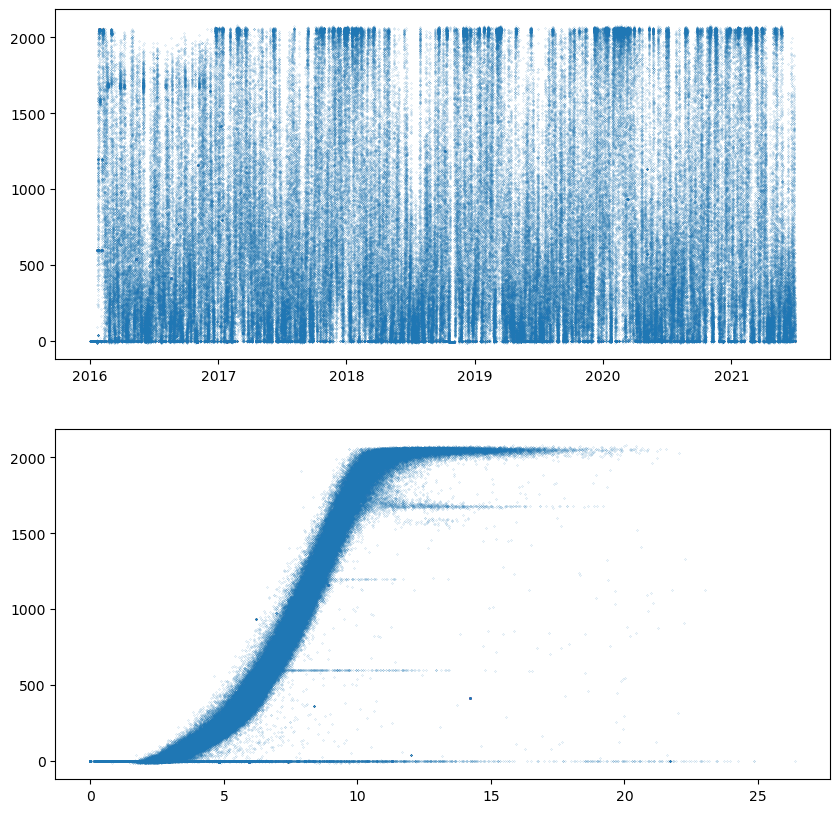

In [14]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(2,1, figsize=(10,10))
ax[0].scatter(df.index,df['value'], s=0.01)
ax[1].scatter(df['wind_speed'],df['value'], s=0.01)


# FEATURE GENERATION

In [15]:

def generate_time_lags(df, var_name, min_lag, max_lag):
  '''Generate a dataframe that is extended by time lags of variabele named var_name
    max_lag: The highest lag will be <=max_lag
    lag_step_size: lag1, lag(1+step_size), ...
  '''
  df_n = df.copy()

  # range starts at 1,6 or 6*24=144
  for n in range(min_lag,max_lag):
    df_n[f"{var_name} lag{n}"] = df_n[f"{var_name}"].shift(n)
  df_n = df_n.iloc[max_lag:]
  return df_n

In [16]:

df_generated = generate_time_lags(df,'value',144,150)
df_generated = generate_time_lags(df_generated,'wind_speed',144,150)
#df_generated = generate_time_lags(df_generated, '')
df_generated[10000:]

wind_speed       value  value lag144  value lag145  \
time                                                                      
2016-03-14 12:40:00        7.00   -2.010000     74.970001    106.889999   
2016-03-14 12:50:00        7.80   -1.370000     96.379997     74.970001   
2016-03-14 13:00:00        8.26   -1.600000     90.029999     96.379997   
2016-03-14 13:10:00        6.72   -2.140000    161.399994     90.029999   
2016-03-14 13:20:00        6.91   -1.480000    102.300003    161.399994   
...                         ...         ...           ...           ...   
2021-06-30 23:10:00        3.85  113.809998    102.059998     72.180000   
2021-06-30 23:20:00        4.06  128.860001     75.099998    102.059998   
2021-06-30 23:30:00        4.00  112.220001     97.889999     75.099998   
2021-06-30 23:40:00        3.59   70.589996    115.379997     97.889999   
2021-06-30 23:50:00        3.42   56.119999    116.089996    115.379997   

                     value lag146  value lag147  value lag148  value lag149  \
time                                                                          
2016-03-14 12:40:00     78.250000     98.830002     58.150002     26.719999   
2016-03-14 12:50:00    106.889999     78.250000     98.830002     58.150002   
2016-03-14 13:00:00     74.970001    106.889999     78.250000     98.830002   
2016-03-14 13:10:00     96.379997     74.970001    106.889999     78.250000   
2016-03-14 13:20:00     90.029999     96.379997     74.970001    106.889999   
...                           ...           ...           ...           ...   
2021-06-30 23:10:00    124.239998    157.080002     77.029999     81.510002   
2021-06-30 23:20:00     72.180000    124.239998    157.080002     77.029999   
2021-06-30 23:30:00    102.059998     72.180000    124.239998    157.080002   
2021-06-30 23:40:00     75.099998    102.059998     72.180000    124.239998   
2021-06-30 23:50:00     97.889999     75.099998    102.059998     72.180000   

                     wind_speed lag144  wind_speed lag145  wind_speed lag146  \
time                                                                           
2016-03-14 12:40:00               3.77               3.84               3.78   
2016-03-14 12:50:00               3.97               3.77               3.84   
2016-03-14 13:00:00               3.86               3.97               3.77   
2016-03-14 13:10:00               4.41               3.86               3.97   
2016-03-14 13:20:00               4.03               4.41               3.86   
...                                ...                ...                ...   
2021-06-30 23:10:00               3.90               3.63               4.25   
2021-06-30 23:20:00               3.60               3.90               3.63   
2021-06-30 23:30:00               3.97               3.60               3.90   
2021-06-30 23:40:00               4.33               3.97               3.60   
2021-06-30 23:50:00               4.30               4.33               3.97   

                     wind_speed lag147  wind_speed lag148  wind_speed lag149  
time                                                                          
2016-03-14 12:40:00               3.92               3.62               2.95  
2016-03-14 12:50:00               3.78               3.92               3.62  
2016-03-14 13:00:00               3.84               3.78               3.92  
2016-03-14 13:10:00               3.77               3.84               3.78  
2016-03-14 13:20:00               3.97               3.77               3.84  
...                                ...                ...                ...  
2021-06-30 23:10:00               4.57               3.56               3.70  
2021-06-30 23:20:00               4.25               4.57               3.56  
2021-06-30 23:30:00               3.63               4.25               4.57  
2021-06-30 23:40:00               3.90               3.63               4.25  
2021-06-30 23:50:00         

In [17]:
df_features= (
  df
  .assign(hour = df.index.hour)
  .assign(month = df.index.month)
)
df_features

wind_speed       value  hour  month
time                                                    
2016-01-03 00:00:00        0.00    0.000000     0      1
2016-01-03 00:10:00        0.00    0.000000     0      1
2016-01-03 00:20:00        0.00    0.000000     0      1
2016-01-03 00:30:00        0.00    0.000000     0      1
2016-01-03 00:40:00        0.00    0.000000     0      1
...                         ...         ...   ...    ...
2021-06-30 23:10:00        3.85  113.809998    23      6
2021-06-30 23:20:00        4.06  128.860001    23      6
2021-06-30 23:30:00        4.00  112.220001    23      6
2021-06-30 23:40:00        3.59   70.589996    23      6
2021-06-30 23:50:00        3.42   56.119999    23      6

[288864 rows x 4 columns]

In [18]:
# Caputre cyclic structure of time features
def generate_cyclic_features(df, col_name, period,start_num=0):
  kwargs = {
    f'sin_{col_name}': lambda x: np.sin(2*np.pi*(df[col_name] -start_num)/period),
    f'cos_{col_name}': lambda x: np.cos(2*np.pi*(df[col_name] -start_num)/period)

  }
  return df.assign(**kwargs).drop(columns=[col_name])

df_features = generate_cyclic_features(df_features, 'hour', 24,0)
df_features = generate_cyclic_features(df_features, 'month', 12,1)
df_features

wind_speed       value  sin_hour  cos_hour  sin_month  \
time                                                                         
2016-01-03 00:00:00        0.00    0.000000  0.000000  1.000000        0.0   
2016-01-03 00:10:00        0.00    0.000000  0.000000  1.000000        0.0   
2016-01-03 00:20:00        0.00    0.000000  0.000000  1.000000        0.0   
2016-01-03 00:30:00        0.00    0.000000  0.000000  1.000000        0.0   
2016-01-03 00:40:00        0.00    0.000000  0.000000  1.000000        0.0   
...                         ...         ...       ...       ...        ...   
2021-06-30 23:10:00        3.85  113.809998 -0.258819  0.965926        0.5   
2021-06-30 23:20:00        4.06  128.860001 -0.258819  0.965926        0.5   
2021-06-30 23:30:00        4.00  112.220001 -0.258819  0.965926        0.5   
2021-06-30 23:40:00        3.59   70.589996 -0.258819  0.965926        0.5   
2021-06-30 23:50:00        3.42   56.119999 -0.258819  0.965926        0.5   

                     cos_month  
time                            
2016-01-03 00:00:00   1.000000  
2016-01-03 00:10:00   1.000000  
2016-01-03 00:20:00   1.000000  
2016-01-03 00:30:00   1.000000  
2016-01-03 00:40:00   1.000000  
...                        ...  
2021-06-30 23:10:00  -0.866025  
2021-06-30 23:20:00  -0.866025  
2021-06-30 23:30:00  -0.866025  
2021-06-30 23:40:00  -0.866025  
2021-06-30 23:50:00  -0.866025  

[288864 rows x 6 columns]

In [19]:
# TODO: Make drop behaviour nicer
df_gen_feat = pd.merge(df_generated, df_features.drop(columns=["wind_speed","value"]), left_index=True, right_index=True).drop(columns=["wind_speed"])
df_gen_feat.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 288564 entries, 2016-01-05 02:00:00 to 2021-06-30 23:50:00
Data columns (total 17 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   value              288564 non-null  float64
 1   value lag144       288564 non-null  float64
 2   value lag145       288564 non-null  float64
 3   value lag146       288564 non-null  float64
 4   value lag147       288564 non-null  float64
 5   value lag148       288564 non-null  float64
 6   value lag149       288564 non-null  float64
 7   wind_speed lag144  288564 non-null  float64
 8   wind_speed lag145  288564 non-null  float64
 9   wind_speed lag146  288564 non-null  float64
 10  wind_speed lag147  288564 non-null  float64
 11  wind_speed lag148  288564 non-null  float64
 12  wind_speed lag149  288564 non-null  float64
 13  sin_hour           288564 non-null  float64
 14  cos_hour           288564 non-null  float64
 15  sin_month        

# DATA SPLITS

In [20]:
from sklearn.model_selection import train_test_split

# Split data set in X and y
def feature_label_split(df, target_col):
    y = df[[target_col]]
    X = df.drop(columns=[target_col])
    return X, y

# Split data in train, validation and test
def train_val_test_split(df, target_col, test_ratio):
    val_ratio = test_ratio / (1 - test_ratio)
    X, y = feature_label_split(df, target_col)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_ratio, shuffle=False)
    X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=val_ratio, shuffle=False)
    return X_train, X_val, X_test, y_train, y_val, y_test


# TODO: Integrate the df_generated aswell!

X_train, X_val, X_test, y_train, y_val, y_test = train_val_test_split(df_gen_feat, 'value', 0.2)

# SCALING

In [21]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
X_train_arr = scaler.fit_transform(X_train)
X_val_arr = scaler.transform(X_val)
X_test_arr = scaler.transform(X_test)

y_train_arr = scaler.fit_transform(y_train)
y_val_arr = scaler.transform(y_val)
y_test_arr = scaler.transform(y_test)

LOADING DATASETS INTO DATALOADERS

In [22]:
from torch.utils.data import TensorDataset, DataLoader

batch_size = 64

train_features = torch.Tensor(X_train_arr)
train_targets = torch.Tensor(y_train_arr)
val_features = torch.Tensor(X_val_arr)
val_targets = torch.Tensor(y_val_arr)
test_features = torch.Tensor(X_test_arr)
test_targets = torch.Tensor(y_test_arr)

train = TensorDataset(train_features, train_targets)
val = TensorDataset(val_features, val_targets)
test = TensorDataset(test_features, test_targets)

train_loader = DataLoader(train, batch_size=batch_size, shuffle=False, drop_last=True)
val_loader = DataLoader(val, batch_size=batch_size, shuffle=False, drop_last=True)
test_loader = DataLoader(test, batch_size=batch_size, shuffle=False, drop_last=True)
test_loader_one = DataLoader(test, batch_size=1, shuffle=False, drop_last=True)

# Model

###  Vanilla RNN

In [23]:
class RNNModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim, dropout_prob):
        super(RNNModel, self).__init__()

        # Defining the number of layers and the nodes in each layer
        self.hidden_dim = hidden_dim
        self.layer_dim = layer_dim

        # RNN layers
        self.rnn = nn.RNN(
            input_dim, hidden_dim, layer_dim, batch_first=True, dropout=dropout_prob
        )
        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # Forward propagation by passing in the input and hidden state into the model
        out, h0 = self.rnn(x, h0.detach())

        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]

        # Convert the final state to our desired output shape (batch_size, output_dim)
        out = self.fc(out)
        return out

### LSTM

In [24]:
class LSTMModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim, dropout_prob):
        super(LSTMModel, self).__init__()

        # Defining the number of layers and the nodes in each layer
        self.hidden_dim = hidden_dim
        self.layer_dim = layer_dim

        # LSTM layers
        self.lstm = nn.LSTM(
            input_dim, hidden_dim, layer_dim, batch_first=True, dropout=dropout_prob
        )

        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # Initializing cell state for first input with zeros
        c0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # We need to detach as we are doing truncated backpropagation through time (BPTT)
        # If we don't, we'll backprop all the way to the start even after going through another batch
        # Forward propagation by passing in the input, hidden state, and cell state into the model
        out, (hn, cn) = self.lstm(x, (h0.detach(), c0.detach()))

        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]

        # Convert the final state to our desired output shape (batch_size, output_dim)
        out = self.fc(out)

        return out

### GRU


In [25]:
class GRUModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, layer_dim, output_dim, dropout_prob):
        super(GRUModel, self).__init__()

        # Defining the number of layers and the nodes in each layer
        self.layer_dim = layer_dim
        self.hidden_dim = hidden_dim

        # GRU layers
        self.gru = nn.GRU(
            input_dim, hidden_dim, layer_dim, batch_first=True, dropout=dropout_prob
        )

        # Fully connected layer
        self.fc = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        # Initializing hidden state for first input with zeros
        h0 = torch.zeros(self.layer_dim, x.size(0), self.hidden_dim).requires_grad_()

        # Forward propagation by passing in the input and hidden state into the model
        out, _ = self.gru(x, h0.detach())

        # Reshaping the outputs in the shape of (batch_size, seq_length, hidden_size)
        # so that it can fit into the fully connected layer
        out = out[:, -1, :]

        # Convert the final state to our desired output shape (batch_size, output_dim)
        out = self.fc(out)

        return out

### Select model

In [26]:
def get_model(model, model_params):
    models = {
        "rnn": RNNModel,
        "lstm": LSTMModel,
        "gru": GRUModel,
    }
    return models.get(model.lower())(**model_params)

### Training

In [27]:
from datetime import datetime
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(torch.cuda.is_available())
class Optimization:
    def __init__(self, model, loss_fn, optimizer):
        self.model = model
        self.loss_fn = loss_fn
        self.optimizer = optimizer
        self.train_losses = []
        self.val_losses = []
    
    def train_step(self, x, y):
        # Sets model to train mode
        self.model.train()

        # Makes predictions
        yhat = self.model(x)

        # Computes loss
        loss = self.loss_fn(y, yhat)

        # Computes gradients
        loss.backward()

        # Updates parameters and zeroes gradients
        self.optimizer.step()
        self.optimizer.zero_grad()

        # Returns the loss
        return loss.item()

        
    def train(self, train_loader, val_loader, batch_size=64, n_epochs=50, n_features=1):
        model_path = f'./models/{self.model}_{datetime.now().strftime("%Y-%m-%d %H:%M:%S")}'

        for epoch in range(1, n_epochs + 1):
            batch_losses = []
            for x_batch, y_batch in train_loader:
                x_batch = x_batch.view([batch_size, -1, n_features]).to(device)
                y_batch = y_batch.to(device)
                loss = self.train_step(x_batch, y_batch)
                batch_losses.append(loss)
            training_loss = np.mean(batch_losses)
            self.train_losses.append(training_loss)

            with torch.no_grad():
                batch_val_losses = []
                for x_val, y_val in val_loader:
                    x_val = x_val.view([batch_size, -1, n_features]).to(device)
                    y_val = y_val.to(device)
                    self.model.eval()
                    yhat = self.model(x_val)
                    val_loss = self.loss_fn(y_val, yhat).item()
                    batch_val_losses.append(val_loss)
                validation_loss = np.mean(batch_val_losses)
                self.val_losses.append(validation_loss)

            if (epoch <= 10) | (epoch % 50 == 0):
                print(
                    f"[{epoch}/{n_epochs}] Training loss: {training_loss:.4f}\t Validation loss: {validation_loss:.4f}"
                )

        torch.save(self.model.state_dict(), model_path)
        
    def evaluate(self, test_loader, batch_size=1, n_features=1):
        with torch.no_grad():
            predictions = []
            values = []
            for x_test, y_test in test_loader:
                x_test = x_test.view([batch_size, -1, n_features]).to(device)
                y_test = y_test.to(device)
                self.model.eval()
                yhat = self.model(x_test)
                predictions.append(yhat.to(device).detach().numpy())
                values.append(y_test.to(device).detach().numpy())

        return predictions, values
    
    def plot_losses(self):
        plt.plot(self.train_losses, label="Training loss")
        plt.plot(self.val_losses, label="Validation loss")
        plt.legend()
        plt.title("Losses")
        plt.show()
        plt.close()

False


### Test evaluation?

[1/2] Training loss: 0.0821	 Validation loss: 0.1038
[2/2] Training loss: 0.0789	 Validation loss: 0.0992


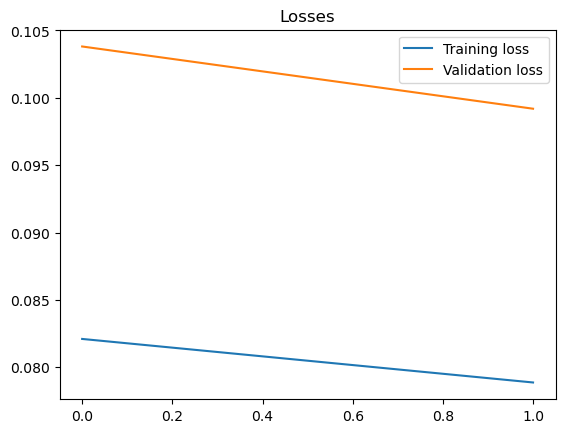

In [28]:
import torch.optim as optim


input_dim = len(X_train.columns)
output_dim = 1
hidden_dim = 64
layer_dim = 3
batch_size = 64
dropout = 0.2
n_epochs = 2
learning_rate = 1e-3
weight_decay = 1e-6

model_params = {'input_dim': input_dim,
                'hidden_dim' : hidden_dim,
                'layer_dim' : layer_dim,
                'output_dim' : output_dim,
                'dropout_prob' : dropout}

model = get_model('lstm', model_params)

loss_fn = nn.MSELoss(reduction="mean")
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=weight_decay)

opt = Optimization(model=model, loss_fn=loss_fn, optimizer=optimizer)
opt.train(train_loader, val_loader, batch_size=batch_size, n_epochs=n_epochs, n_features=input_dim)
opt.plot_losses()

predictions, values = opt.evaluate(test_loader_one, batch_size=1, n_features=input_dim)

In [33]:
values

[array([[0.12232235]], dtype=float32),
 array([[0.12093344]], dtype=float32),
 array([[0.1062679]], dtype=float32),
 array([[0.09333304]], dtype=float32),
 array([[0.10329553]], dtype=float32),
 array([[0.05740878]], dtype=float32),
 array([[0.04480933]], dtype=float32),
 array([[0.04444415]], dtype=float32),
 array([[0.03610731]], dtype=float32),
 array([[0.04060668]], dtype=float32),
 array([[0.03282041]], dtype=float32),
 array([[0.03693961]], dtype=float32),
 array([[0.03276883]], dtype=float32),
 array([[0.05019668]], dtype=float32),
 array([[0.06589689]], dtype=float32),
 array([[0.05107621]], dtype=float32),
 array([[0.04036589]], dtype=float32),
 array([[0.02650926]], dtype=float32),
 array([[0.02543234]], dtype=float32),
 array([[0.01591543]], dtype=float32),
 array([[0.00886064]], dtype=float32),
 array([[0.01166688]], dtype=float32),
 array([[0.01341836]], dtype=float32),
 array([[0.00624838]], dtype=float32),
 array([[0.00755159]], dtype=float32),
 array([[0.01573735]], dty

### invert the batching and scaling for prediction and error metrics

In [29]:
def inverse_transform(scaler, df, columns):
    for col in columns:
        df[col] = scaler.inverse_transform(df[col])
    return df


def format_predictions(predictions, values, df_test, scaler):
    vals = np.concatenate(values, axis=0).ravel()
    preds = np.concatenate(predictions, axis=0).ravel()
    df_result = pd.DataFrame(data={"value": vals, "prediction": preds}, index=df_test.head(len(vals)).index)
    df_result = df_result.sort_index()
    df_result = inverse_transform(scaler, df_result, [["value", "prediction"]])
    return df_result


df_result = format_predictions(predictions, values, X_test, scaler)
df_result

value  prediction
time                                       
2020-05-26 05:10:00  238.940308  386.616486
2020-05-26 05:20:00  236.026184  387.402161
2020-05-26 05:30:00  205.255707  388.936951
2020-05-26 05:40:00  178.116470  390.758392
2020-05-26 05:50:00  199.019241  393.202850
...                         ...         ...
2021-06-30 23:10:00  113.809990  415.667328
2021-06-30 23:20:00  128.859985  415.016632
2021-06-30 23:30:00  112.219994  415.771698
2021-06-30 23:40:00   70.589989  415.395813
2021-06-30 23:50:00   56.119999  415.195862

[57713 rows x 2 columns]

In [30]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

def calculate_metrics(df):
    return {'mae' : mean_absolute_error(df.value, df.prediction),
            'rmse' : mean_squared_error(df.value, df.prediction) ** 0.5,
            'r2' : r2_score(df.value, df.prediction)}

result_metrics = calculate_metrics(df_result)
result_metrics

{'mae': 499.17474, 'rmse': 641.2847700125117, 'r2': 0.06907159991921086}

In [31]:
from sklearn.linear_model import LinearRegression

def build_baseline_model(df, test_ratio, target_col):
    X, y = feature_label_split(df, target_col)
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=test_ratio, shuffle=False
    )
    model = LinearRegression()
    model.fit(X_train, y_train)
    prediction = model.predict(X_test)

    result = pd.DataFrame(y_test)
    result["prediction"] = prediction
    result = result.sort_index()

    return result

df_baseline = build_baseline_model(df_gen_feat, 0.2, 'value')
baseline_metrics = calculate_metrics(df_baseline)
baseline_metrics

{'mae': 492.44879792456675,
 'rmse': 609.9064226758763,
 'r2': 0.15794426586176646}

In [32]:
import plotly.offline as pyo
import plotly.graph_objects as go

def plot_predictions(df_result, df_baseline):
    data = []
    
    value = go.Scatter(
        x=df_result.index,
        y=df_result.value,
        mode="lines",
        name="values",
        marker=dict(),
        text=df_result.index,
        line=dict(color="rgba(0,0,0, 0.3)"),
    )
    data.append(value)

    baseline = go.Scatter(
        x=df_baseline.index,
        y=df_baseline.prediction,
        mode="lines",
        line={"dash": "dot"},
        name='linear regression',
        marker=dict(),
        text=df_baseline.index,
        opacity=0.8,
    )
    data.append(baseline)
    
    prediction = go.Scatter(
        x=df_result.index,
        y=df_result.prediction,
        mode="lines",
        line={"dash": "dot"},
        name='predictions',
        marker=dict(),
        text=df_result.index,
        opacity=0.8,
    )
    data.append(prediction)
    
    layout = dict(
        title="Predictions vs Actual Values for the dataset",
        xaxis=dict(title="Time", ticklen=5, zeroline=False),
        yaxis=dict(title="Value", ticklen=5, zeroline=False),
    )

    fig = dict(data=data, layout=layout)
    pyo.iplot(fig)
    
    
# Set notebook mode to work in offline
pyo.init_notebook_mode()

plot_predictions(df_result, df_baseline)